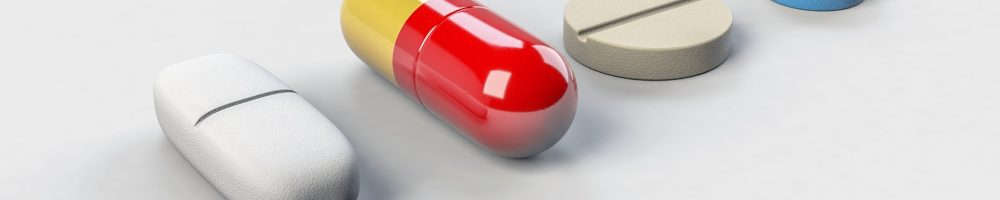

<center/>

# Исследование влияния аугментаций на прогностическую способность модели

<center/>
<b>ИСТ, 2020</b>

<h1>Содержание<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Настройка-среды" data-toc-modified-id="Настройка-среды-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Настройка среды</a></span><ul class="toc-item"><li><span><a href="#Библиотеки" data-toc-modified-id="Библиотеки-1.1"><span class="toc-item-num">1.1&nbsp;&nbsp;</span>Библиотеки</a></span><ul class="toc-item"><li><span><a href="#Подключение-библиотек" data-toc-modified-id="Подключение-библиотек-1.1.1"><span class="toc-item-num">1.1.1&nbsp;&nbsp;</span>Подключение библиотек</a></span></li></ul></li><li><span><a href="#Константы" data-toc-modified-id="Константы-1.2"><span class="toc-item-num">1.2&nbsp;&nbsp;</span>Константы</a></span></li></ul></li><li><span><a href="#Код" data-toc-modified-id="Код-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Код</a></span><ul class="toc-item"><li><span><a href="#Визуализация" data-toc-modified-id="Визуализация-2.1"><span class="toc-item-num">2.1&nbsp;&nbsp;</span>Визуализация</a></span><ul class="toc-item"><li><span><a href="#Визуализация-карт-изображений" data-toc-modified-id="Визуализация-карт-изображений-2.1.1"><span class="toc-item-num">2.1.1&nbsp;&nbsp;</span>Визуализация карт изображений</a></span></li></ul></li><li><span><a href="#Генерация-данных" data-toc-modified-id="Генерация-данных-2.2"><span class="toc-item-num">2.2&nbsp;&nbsp;</span>Генерация данных</a></span><ul class="toc-item"><li><span><a href="#Создание-кропов" data-toc-modified-id="Создание-кропов-2.2.1"><span class="toc-item-num">2.2.1&nbsp;&nbsp;</span>Создание кропов</a></span></li><li><span><a href="#Аугментации" data-toc-modified-id="Аугментации-2.2.2"><span class="toc-item-num">2.2.2&nbsp;&nbsp;</span>Аугментации</a></span></li><li><span><a href="#Регистр-аугментаций" data-toc-modified-id="Регистр-аугментаций-2.2.3"><span class="toc-item-num">2.2.3&nbsp;&nbsp;</span>Регистр аугментаций</a></span></li></ul></li><li><span><a href="#Исследование-данных" data-toc-modified-id="Исследование-данных-2.3"><span class="toc-item-num">2.3&nbsp;&nbsp;</span>Исследование данных</a></span><ul class="toc-item"><li><span><a href="#Создание-анализатора" data-toc-modified-id="Создание-анализатора-2.3.1"><span class="toc-item-num">2.3.1&nbsp;&nbsp;</span>Создание анализатора</a></span></li><li><span><a href="#Загрузка-модели,-предсказание-на-кропах" data-toc-modified-id="Загрузка-модели,-предсказание-на-кропах-2.3.2"><span class="toc-item-num">2.3.2&nbsp;&nbsp;</span>Загрузка модели, предсказание на кропах</a></span></li><li><span><a href="#Аугментация" data-toc-modified-id="Аугментация-2.3.3"><span class="toc-item-num">2.3.3&nbsp;&nbsp;</span>Аугментация</a></span></li><li><span><a href="#Регистр-аугментаций" data-toc-modified-id="Регистр-аугментаций-2.3.4"><span class="toc-item-num">2.3.4&nbsp;&nbsp;</span>Регистр аугментаций</a></span></li><li><span><a href="#Анализ-аугментаций" data-toc-modified-id="Анализ-аугментаций-2.3.5"><span class="toc-item-num">2.3.5&nbsp;&nbsp;</span>Анализ аугментаций</a></span><ul class="toc-item"><li><span><a href="#Загрузка-модели" data-toc-modified-id="Загрузка-модели-2.3.5.1"><span class="toc-item-num">2.3.5.1&nbsp;&nbsp;</span>Загрузка модели</a></span></li><li><span><a href="#Анализ" data-toc-modified-id="Анализ-2.3.5.2"><span class="toc-item-num">2.3.5.2&nbsp;&nbsp;</span>Анализ</a></span></li><li><span><a href="#Визуализация" data-toc-modified-id="Визуализация-2.3.5.3"><span class="toc-item-num">2.3.5.3&nbsp;&nbsp;</span>Визуализация</a></span></li></ul></li></ul></li></ul></li></ul></div>

## Настройка среды

### Библиотеки

#### Подключение библиотек

In [20]:
import imp
import math
import os
import shutil
import warnings
from glob import glob
from typing import Dict, List

import innvestigate
import innvestigate.utils as iutils
import innvestigate.utils.visualizations as ivis
import keras
import matplotlib.gridspec as gridspec
import matplotlib.pyplot as plt
import ntpath
import numpy as np
import pandas as pd
import pyvips
import seaborn as sns
import staintools
from bs4 import BeautifulSoup
from innvestigate.applications import imagenet as imgnet
from IPython.display import HTML, clear_output, display
from keras import Model
from keras.layers import Conv2D
from py_linq import Enumerable
from tqdm.notebook import tqdm
import base64
from bs4 import Tag
from skimage.transform import rescale, resize

# Настройка библтотек
plt.rcParams['svg.fonttype'] = 'none'

warnings.filterwarnings('ignore')
%matplotlib inline

### Константы

In [2]:
ORIGINAL_IMAGES_PATH = 'data/imgs/'
CROPS_PATH = 'data/crops/'
PRETRAINED_MODELS = 'models/'

## Код

### Визуализация

#### Визуализация карт изображений

In [3]:
class Presentation:
    def create_image_map(self,
                         imgs: list,
                         title: str = None,
                         left_titles: List[str] = [],
                         top_titles: List[str] = [],
                         right_titles: List[str] = [],
                         all_bottom_titles: List[str] = [],
                         fig_size=(15, 15),
                         hspace=0.01,
                         wspace=0.01,
                         dpi=300,
                         title_font_size=15,
                         top_font_size=15,
                         left_font_size=15,
                         right_font_size=15,
                         bottom_font_size = 15,
                         style=0,
                         save_in_file=False,
                         file_name='img001.svg',
                         embedded_show=True):

        styles = ['darkgrid', 'whitegrid', 'dark', 'white',
                  'ticks']  # Набор стилей
        plt.rcParams[u'figure.dpi'] = dpi  # Разрешение изображения
        sns.set_style(styles[style])  # Стиль
        fig = plt.figure(figsize=fig_size)  # Размер изображения
        ncols = len(imgs[0])  # Ширина сетки
        nrows = len(imgs)  # Высота сетки
        # Названия сверху, слева и справа
        t_ttls = top_titles.copy()
        r_ttls = right_titles.copy()
        l_ttls = left_titles.copy()
        ab_ttls = all_bottom_titles.copy()

        gs = gridspec.GridSpec(ncols=ncols, nrows=nrows, figure=fig)  # Сетка
        for row in range(nrows):
            for col in range(ncols):
                fig.add_subplot(gs[row, col])  # Добавить плот
                current_img = imgs[row, col]  # Извлечение текущего изображения
                plt.imshow(current_img)  # Отображение картинки

                if len(t_ttls) > 0:
                    if row == 0:  # Если идем по первому ряду
                        plt.title(label=t_ttls.pop(0),
                                  weight="heavy",
                                  fontsize=top_font_size,
                                  fontname='DejaVu Sans',
                                  rotation=22.5,
                                  horizontalalignment='left',
                                  verticalalignment='bottom')
                if len(r_ttls) > 0:
                    if col == ncols - 1:
                        ax = plt.gca()
                        ax.yaxis.set_label_position("right")
                        plt.ylabel(r_ttls.pop(0),
                                   fontsize=right_font_size,
                                   fontname='DejaVu Sans',
                                   color='black',
                                   weight="heavy")
                if len(l_ttls) > 0:
                    if col == 0:
                        ax = plt.gca()
                        ax.yaxis.set_label_position("left")
                        plt.ylabel(left_titles.pop(0),
                                   fontsize=left_font_size,
                                   fontname='DejaVu Sans',
                                   color='black',
                                   weight="heavy")
                if len(ab_ttls) > 0:
                    plt.xlabel(ab_ttls.pop(0),
                                   fontsize=bottom_font_size,
                                   fontname='DejaVu Sans',
                                   color='black',
                                   weight="heavy")
                plt.grid(False)  # Не показываем сетку
                plt.yticks([])  # Скрываем тики оси y
                plt.xticks([])  # Скрываем тики оси x
        if title != None:  # Добавляем заголовок
            fig.suptitle(title, fontsize=title_font_size)
        plt.subplots_adjust(hspace=hspace, wspace=wspace)
        if save_in_file == True:
            plt.tight_layout()
            plt.savefig(file_name, format="svg")
        plt.autoscale(enable=True, axis='both', tight=None)
        plt.show()

### Генерация данных

#### Создание кропов

Создание дата-сета для гистологических снимков большого разрешения. Функция принимает на вход путь к папке с исходными изображениями, путь к папке назначения, размер нарезаемых изображений.

Из оригинального изображения, нарезаются области (кропы) определенного размера равные по высоте и ширине друг другу. При нарезании происходит перемещение "инструмента" равными частями по изображению слава направо и сверху вниз. При достижении правого края и на последнем проходе нижнего края изображения, есть вероятность что кроп может получиться размера отличного от заданного. В этом случае недостающая часть изображения замещается у предыдущего, т.е. дополняется до нужного размера. В случае правого края "инструмент" смещается влево, в случае нижнего края инструмент смещается вверх.

В результате по пути назначения генерируется папка с именем исходного изображения и в нее помешаются нарезанные изображения с именами tail_1.png, tail_2.png и т.д.

**Методы обрезки изображений**

In [4]:
class Crop:
    def __init__(self, img_path: str, crop_path: str, crop_width, crop_height):
        self.img_path = img_path
        self.crop_path = crop_path
        self.crop_width = crop_width
        self.crop_height = crop_height

    def libvips_crop(self) -> None:
        """
        Нарезает исходные изображения на кропы нужного размера
        :param src_path: str
            Путь к пвпке с изображениями
        :param dest_path: str
            Путь к папке с результатами
        :param crop_width: int
            Ширина кропа
        :param crop_height: int
            Высота кропа
        :return: None        
        """

        summary_dict = {}
        for img in glob(os.path.join(self.img_path,
                                     "*")):  # Итерация по списку изображений
            img_name = ntpath.basename(img)  # Имя изображения
            print("Cropping: ", img)
            summary_dict[img] = 0  # Начальное количество кропов

            if os.path.exists(os.path.join(
                    self.crop_path, img_name)):  # Проверка существования папки
                shutil.rmtree(os.path.join(self.crop_path,
                                           img_name))  # Удаление папки
            os.mkdir(os.path.join(self.crop_path,
                                  img_name))  # Создание новой папки

            image = pyvips.Image.new_from_file(
                img, access='sequential')  # Загрузка изображения
            h_count = list(range(math.ceil(
                image.height /
                self.crop_height)))  # Количество перемещений по высоте

            w_count = list(range(math.ceil(
                image.width /
                self.crop_width)))  # Количество перемещений по ширине

            imgs_index = list(range(len(h_count) *
                                    len(w_count)))  # Индексы кропов

            for i, h in enumerate(tqdm(
                    h_count, desc='Cropping...  ')):  # Итерация по изображению
                for j, w in enumerate(w_count):
                    h_end = h * self.crop_height + self.crop_height  # Верхняя координата
                    w_end = w * self.crop_width + self.crop_width  # Левая координата
                    crop_offset_h = 0  # Смещение от координат по умолчанию
                    crop_offset_w = 0

                    if w_end > image.width:  # Проверка выхода за края кропа

                        crop_offset_w = self.crop_width - (
                            image.width - w * self.crop_width
                        )  # Смещаем кроп чтобы получить правильный
                    if h_end > image.height:
                        crop_offset_h = self.crop_height - (
                            image.height - h * self.crop_height
                        )  # Смещаем кроп чтобы получить правильный

                    tile = image.crop(w * self.crop_width - crop_offset_w,
                                      h * self.crop_height - crop_offset_h,
                                      self.crop_width,
                                      self.crop_height)  # Кропаем

                    indx = imgs_index.pop(0)  # Извлечение индекса кропа
                    file_name = f"tile_{indx}.png"  # Имя файла

                    tile.write_to_file(
                        os.path.join(os.path.join(self.crop_path, img_name),
                                     file_name))  # Сохраняем в файл
                    summary_dict[img] = (summary_dict[img] + 1
                                         )  # Увеличиваем счетчик кропов
            clear_output()  # Очищаем информацию и прогресс-бары
        for k, v in summary_dict.items(
        ):  # Печатаем статистику по количеству кропов
            print(f"{k}: {v} crops.")

**Кроп**

In [5]:
CROP_WIDTH=240
CROP_HEIGHT=240

In [ ]:
crop = Crop(img_path=ORIGINAL_IMAGES_PATH,
            crop_path=CROPS_PATH,
            crop_width=CROP_WIDTH,
            crop_height=CROP_HEIGHT)
# Нарезка изображений
crop.libvips_crop()

**Просмотр результатов**

In [6]:
CROPED_IMGS = os.listdir(CROPS_PATH)
print("Список нарезанных изображений: ", CROPED_IMGS)

Список нарезанных изображений:  ['1.svs', '8315-17.scn']


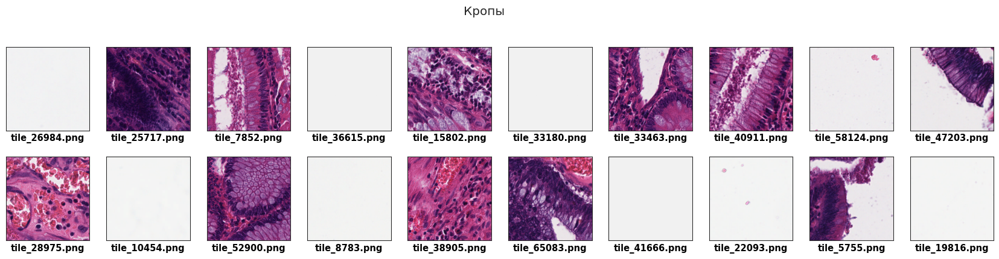

In [424]:
start_position = 3060
imgs_paths = glob(os.path.join(CROPS_PATH, CROPED_IMGS[0], '*'))
imgs_names = [ntpath.basename(p)  for p in imgs_paths]

img_arr = np.array([
    plt.imread(img)
    for img in imgs_paths
    [start_position:start_position + 20]
]).reshape((2, 10, CROP_WIDTH, CROP_HEIGHT, 3))

Presentation().create_image_map(imgs=img_arr,
                                title="Кропы",
                                all_bottom_titles=imgs_names,
                                fig_size=(22, 5),
                                hspace=0.01,
                                wspace=0.2,
                                title_font_size=15,
                                bottom_font_size=11,
                                style=3,
                                dpi=96)

#### Аугментации

Для того чтобы получить больше данных для обучения модели можно применить технику аугментаций, т.е на основе исходного изображения сгенерировать много похожих но немного измененных вариантов.

**Stain-аугментации**

Обертка над библиотекой для геренраци цветовых аугментаций: https://hackmd.io/@r1Fblb_BQgeEQi_ZHSYnsg/SJ7o7pk1N?type=view

Получает на вход изрбражения для аугммментаций, путь для сохранения преобразованных изображений, параметры для библиотеки. В результате по пути назначения генериуется папка с именем изображения и которую помещаются аугментированные новые изрбражения с именами описывающими преобразованные параметры над изображением типа: [param1]$[value1]@[param2]$[value2]@[param3]$[value3]@[param4]$[value4]@[augmentation_number].png

**Методы аугментации**

In [7]:
class Augmentations:
    def __init__(self, img_paths: List[str], aug_path: str):
        self.img_paths = img_paths
        self.aug_path = aug_path

    def staintool_augmentation(self,
        range_count: int = 100,
        params: Dict[str, str] = {
            'method': 'vahadane',
            'sigma1': 0.5,
            'sigma2': 0.5,
            'augment_background': True
        }
    ) -> None:
        for img in self.img_paths:
            # Имя изображения
            img_name = ntpath.basename(img)
            # Директория с аугментациями для метода
            augment_img_directory = os.path.join(self.aug_path, img_name)
            # Проверка существования папки для изображения
            if not os.path.exists(augment_img_directory):
                # shutil.rmtree(augment_type_directory)  # Удаление папки
                os.mkdir(augment_img_directory)  # Создание новой папки

            to_augment = staintools.read_image(img)
            to_augment = staintools.LuminosityStandardizer.standardize(
                to_augment)
            augmentor = staintools.StainAugmentor(**params)
            augmentor.fit(to_augment)

            for num in range(range_count):
                augmented_image = augmentor.pop()
                # Строка параметров
                parmas_line = '@'.join(
                    [f"{str(k)}${str(v)}" for k, v in params.items()])
                # Имя файла
                file_name = f"{parmas_line}@{num}"
                # Сохранение изображения
                plt.imsave(
                    f"{os.path.join(augment_img_directory, file_name)}.png",
                    augmented_image / 255)

**Аугментация**

In [8]:
STAIN_AUGMENTATION = 'data/aug/stain/'

In [34]:
img_selected_index = 2355
stain_params = dict(method='vahadane',
                    sigma1=3,
                    sigma2=3,
                    augment_background=False)

augmentation = Augmentations(img_paths=glob(
    os.path.join(CROPS_PATH, CROPED_IMGS[0],
                 "*"))[img_selected_index:img_selected_index + 1],
                             aug_path=STAIN_AUGMENTATION)

augmentation.staintool_augmentation(range_count=10, params=stain_params)

**Просмотр результатов**

In [9]:
AUGMENTED_IMAGES = os.listdir(STAIN_AUGMENTATION)

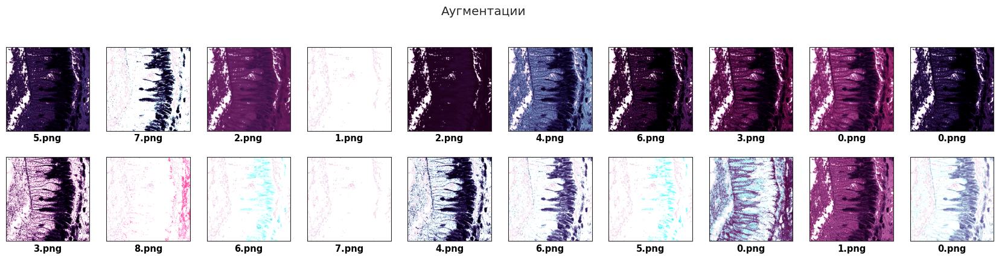

In [420]:
imgs_paths = glob(
        os.path.join(STAIN_AUGMENTATION, AUGMENTED_IMAGES[0], '*'))
imgs_names = [ntpath.basename(p).split('@')[-1]  for p in imgs_paths]
img_arr = np.array([
    plt.imread(img) for img in glob(
        os.path.join(STAIN_AUGMENTATION, AUGMENTED_IMAGES[0], '*'))[0:20]
])[:, :, :, :3].reshape((2, 10, CROP_WIDTH, CROP_HEIGHT, 3))

Presentation().create_image_map(imgs=img_arr,
                                title="Аугментации",
                                all_bottom_titles=imgs_names,
                                fig_size=(22, 5),
                                hspace=0.01,
                                wspace=0.2,
                                title_font_size=15,
                                bottom_font_size=11,
                                style=3,
                                dpi=96)

#### Регистр аугментаций

In [10]:
class AugResult:
    """
    Описывает параметры сводки по аугментации
    """
    def __init__(self, base_image, param_group, value_group, augmentations):
        self.base_image = base_image
        self.param_group = param_group
        self.value_group = value_group
        self.augmentations = augmentations


class AugParameter:
    """
    Описывает параметры аугментации
    """
    def __init__(self, name: str, value):
        self.name = name
        self.value = value


class AugExample:
    """
    Описывает аугментацию
    """
    def __init__(self, full_name: str, number, base_image_name: str,
                 param_id: str, value_id: str, pretty_params: str,
                 params: List[AugParameter]):
        self.full_name: str = full_name
        self.number = number
        self.base_image_name = base_image_name
        self.param_id = param_id
        self.value_id = value_id
        self.pretty_params = pretty_params
        self.params: List[AugParameter] = params


class AugImg:
    def __init__(self, name: str, examples: List[AugExample]):
        self.name = name
        self.examples = examples


class AugRegister:
    def __init__(self, name: str, path: str):
        # Имя регистра аугментаций
        self.name = name
        self.path = path
        self.examples: List[AugExample] = list()
        self.base_images: List[str] = list()

        self._configure()

    def _configure(self):
        # Проход по базовым изображениям
        for bi in os.listdir(self.path):
            self.base_images.append(bi)
            # Проход по аугментациям
            for img in glob(os.path.join(os.path.join(self.path, bi), '*')):
                full_name = ntpath.basename(img)
                splitted_name = full_name.split('@')
                number = splitted_name[-1].split(".")[0]
                pars = splitted_name[:-1]
                # Генерация параметров
                param_list = [
                    AugParameter(name=par.split('$')[0],
                                 value=par.split('$')[1]) for par in pars
                ]
                # Идентификатор по параметрам
                param_id = '@'.join([par.name for par in param_list])
                # Идентификатоп по значениям
                value_id = '@'.join([par.value for par in param_list])
                pretty_params = '@'.join([
                    f"{p}={v}"
                    for p, v in zip([par.name for par in param_list],
                                    [par.value for par in param_list])
                ])
                self.examples.append(
                    AugExample(full_name=full_name,
                               number=number,
                               base_image_name=bi,
                               param_id=param_id,
                               value_id=value_id,
                               pretty_params=pretty_params,
                               params=param_list))

    def _get_augnentaitions(self, base_image_name) -> List[AugExample]:
        """
        Возвращает аугментации
        """
        return Enumerable(self.examples).where(
            lambda x: x.base_image_name == base_image_name).to_list()

    def aug_param_groups(self, base_image: str):
        augs = self._get_augnentaitions(
            base_image)  # Аугментации для базового изображения
        return list(
            pd.Series(Enumerable(augs).select(
                lambda x: x.param_id).to_list()).value_counts().index)

    def aug_values_group(self, base_image: str, param_id: str):
        augs = self._get_augnentaitions(
            base_image)  # Аугментации для базового изображения
        return list(
            pd.Series(
                Enumerable(augs).where(lambda x: x.param_id == param_id).
                select(lambda x: x.value_id).to_list()).value_counts().index)

    def augmentations(self, base_image: str, value_id: str):
        augs = self._get_augnentaitions(
            base_image)  # Аугментации для базового изображения
        return Enumerable(augs).where(lambda x: x.value_id == value_id
                                      ).order_by(lambda x: x.number).to_list()

    def aug_result(self):
        result = []
        base_aug_images = self.base_images()
        for base_image in base_aug_images:
            for param_group in self.aug_param_groups(base_image):
                for value_group in self.aug_values_group(
                        base_image, param_group):
                    result.append(
                        AugResult(base_image=base_image,
                                  param_group=param_group,
                                  value_group=value_group,
                                  augmentations=self.augmentations(
                                      base_image, value_group)))
        return result

**Визуализация результатов**

Метод get_all_augmentations должен вернуть список путй к изображениям отсортированным по параметрам и значениям параметров которые применялись к изображениям

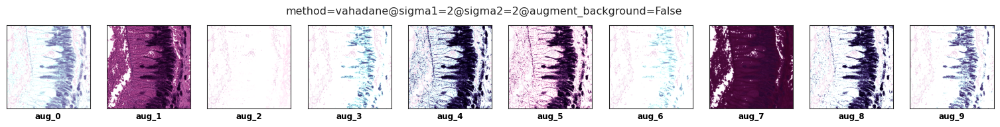

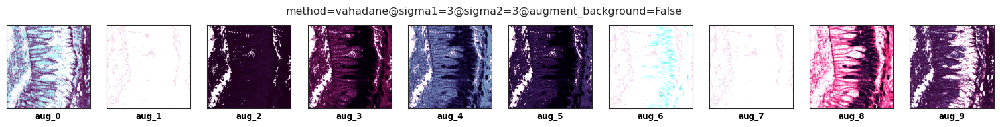

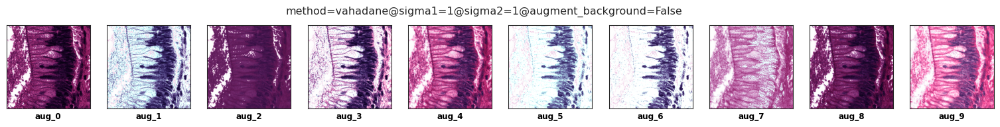

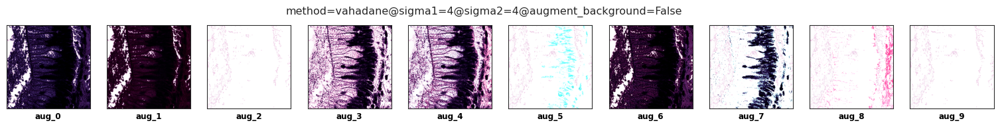

In [402]:
stain_register = AugRegister(name='stain', path=STAIN_AUGMENTATION)
for bi in stain_register.base_images:
    display(
        HTML(f'<h4 align="center" style="color:blue">' +
             f'Изображение - {bi.upper()}</h4>'))
    for param_id in stain_register.aug_param_groups(bi):
        display(HTML(f'<h5 align="center">Набор параметров - {param_id}</h5>'))
        for value_id in stain_register.aug_values_group(bi, param_id):
            augs = stain_register.augmentations(bi, value_id)
            # Визуализация изображений
            img_arr = np.array([
                plt.imread(
                    os.path.join(STAIN_AUGMENTATION, aug.base_image_name,
                                 aug.full_name))[:, :, :3] for aug in augs
            ]).reshape((1, 10, CROP_WIDTH, CROP_HEIGHT, 3))
            Presentation().create_image_map(
                imgs=img_arr,
                all_bottom_titles=Enumerable(augs).select(
                    lambda x: f'aug_{x.number}').to_list(),
                title=Enumerable(augs).select(
                    lambda x: x.pretty_params).to_list()[0],
                fig_size=(20, 2),
                hspace=0.01,
                wspace=0.2,
                title_font_size=12,
                bottom_font_size=9,
                style=3,
                dpi=96)

### Исследование данных

#### Создание анализатора

Анализатор позвоялет понять как изменяется уверенность модели в предсказании при добавлении смене аугментации

In [22]:
class ImageNetINNvestigate():
    def __init__(self,
                 model: Model,
                 model_base_type: str = 'resnet50',
                 load_patterns='relu'):
        self.model = model
        self.model_base_type = model_base_type
        self.load_patterns = load_patterns

        self.patterns = (None if self.load_patterns == False else
                         imgnet._prepare_keras_net(
                             netname=self.model_base_type,
                             clazz=keras.applications.vgg16.VGG16,
                             image_shape=[224, 224],
                             preprocess_f=None,
                             load_patterns=self.load_patterns))['patterns']

        self._color_coding = {
            "vgg16": "BGR",
            "vgg19": "BGR",
            "resnet50": "BGR",
            "inception_v3": "RGB",
            "inception_resnet_v2": "RGB",
            "densenet121": "RGB",
            "densenet169": "RGB",
            "densenet201": "RGB",
            "nasnet_large": "BGR",
            "nasnet_mobile": "BGR"
        }
        self.color_coding = self._color_coding[model_base_type]

        self.preprocess_mode = dict(
            zip(list(self._color_coding.keys()), [
                "caffe", "caffe", "caffe", "tf", "tf", "torch", "torch",
                "torch", "tf", "tf"
            ]))[model_base_type]

        self.input_range = {
            None: (-128, 128),
            "caffe": (-128, 128),
            "tf": (-1, 1),
            "torch": (-3, 3),
        }[self.preprocess_mode]

        self.noise_scale = (self.input_range[1] - self.input_range[0]) * 0.1

        self.METHODS = [
            'gradient', 'smoothgrad', 'deconvnet', 'guided_backprop',
            'pattern.net', 'pattern.attribution', 'deep_taylor.bounded',
            'input_t_gradient', 'integrated_gradients', 'lrp.z', 'lrp.epsilon',
            'lrp.sequential_preset_a_flat', 'lrp.sequential_preset_b_flat'
        ]

        self.PARAMS = [{
            "postprocess": "abs"
        }, {
            "augment_by_n": 16,
            "noise_scale": self.noise_scale,
            "postprocess": "square"
        }, {}, {}, {
            "patterns": self.patterns
        }, {
            "patterns": self.patterns
        }, {
            "low": self.input_range[0],
            "high": self.input_range[1]
        }, {}, {
            "reference_inputs": self.input_range[0],
            "steps": 16
        }, {}, {
            "epsilon": 1
        }, {
            "epsilon": 1
        }, {
            "epsilon": 1
        }]

        self.POSTPROCESSING = dict(
            zip(self.METHODS, [
                self._graymap, self._graymap, self._bk_proj, self._bk_proj,
                self._bk_proj, self._heatmap, self._heatmap, self._heatmap,
                self._heatmap, self._heatmap, self._heatmap, self._heatmap,
                self._heatmap
            ]))

        self.channels_first = keras.backend.image_data_format(
        ) == "channels_first"
        self.color_conversion = ("BGRtoRGB"
                                 if self.color_coding == "BGR" else None)

        # Создание анализаторов
        self._create_analysers()

    def postprocess(self, X, color_conversion, channels_first):
        X = X.copy()
        X = iutils.postprocess_images(X,
                                      color_coding=color_conversion,
                                      channels_first=channels_first)
        return X

    def image(self, X):
        X = X.copy()
        return ivis.project(X, absmax=255.0, input_is_positive_only=True)

    def _bk_proj(self, X):
        X = ivis.clip_quantile(X, 1)
        return ivis.project(X)

    def _heatmap(self, X):
        #X = ivis.gamma(X, minamp=0, gamma=0.95)
        return ivis.heatmap(X)

    def _graymap(self, X):
        return ivis.graymap(np.abs(X), input_is_positive_only=True)

    def _create_analysers(self):
        """
        Создает анализаторы на основе модели
        """
        # Список созданных анализаторов
        self.analyzers = {}
        for method, param in zip(self.METHODS, self.PARAMS):
            try:
                self.analyzers[method] = innvestigate.create_analyzer(
                    name=method, model=model, **param)
            except innvestigate.NotAnalyzeableModelException as exe:
                #                 print(exe)
                pass
        print(f"Creared {len(self.analyzers)} analyzers")

    def analyze(self, img):
        """
        Анализирует изображение
        """
        analyze_result_arr = []
        for analyzer_name, analyzer in self.analyzers.items(
        ):  # Применение анализатора к изображению
            analyze_result = analyzer.analyze(
                img)  # Анализ изображения по одному из методов
            analyze_result = self.postprocess(  # Постобработка общая
                analyze_result, self.color_conversion, self.channels_first)
            # Постобработка конкретная, для метода
            analyze_result = self.POSTPROCESSING[analyzer_name](analyze_result)
            analyze_result_arr.append(analyze_result)
        return analyze_result_arr

#### Загрузка модели, предсказание на кропах

In [12]:
# Загрузка модели из файла скрипта
resnet50_model = imp.load_source("model_resnet50",
                                 "models/resnet50/resnet50s.py").get_model(
                                     240, 3, 2)
# Загрузка весов
resnet50_model.load_weights(
    'models/resnet50/resnet50s_stage3_v2_model_7878_2_best.hdf5')

In [13]:
# Выбор 5000 кропов
crops = glob(os.path.join(CROPS_PATH, CROPED_IMGS[0], '*'))[20000:25000]
# Предподготовка изображений
prepared_imgs = [(plt.imread(crop).astype('float') )[:, :, :3].reshape(
    (240, 240, 3)) for crop in crops]
prepared_imgs = np.array(prepared_imgs) # Все изображения в 1 тензор

In [14]:
# Предсказания модели
predicted = resnet50_model.predict(prepared_imgs, batch_size=100)

In [15]:
base64_imgs = [
    '<img width="70" alt="2d array" src="data:image/png;base64, ' +
    base64.b64encode(open(crop, 'rb').read()).decode() + '"/>'
    for crop in crops
]

In [16]:
predicted_prop_df = pd.DataFrame([{
    'propab_follicular_cancer': pred[0],
    'propab_adenoma': pred[1],
    'follicular_cancer': int(pred[0] > pred[1]),
    'adenoma': int(pred[1] > pred[0]),
    'url': crop,
    "img": img
} for pred, crop, img in zip(predicted, crops, base64_imgs)])

In [17]:
# Выбираем изображения в которых сеть максимально, 
# средне и минимально уверена для follicular_cancer, и adenoma
selected_df = {}
for class_type, propab_type in zip(
    ['follicular_cancer', 'adenoma'],
    ['propab_follicular_cancer', 'propab_adenoma']):
    # Выбор минимального и максимального значения
    for vtype, vvalue in zip(['min', 'max'], [True, False]):
        selected_df[f'{vtype}__{class_type}'] = predicted_prop_df[
            predicted_prop_df[class_type] == 1].sort_values(
                by=[propab_type], ascending=vvalue).head(1)

    # Выбор среднего
    # Находим среднее значение
    mean_val = predicted_prop_df[predicted_prop_df[class_type] ==
                                 1][propab_type].mean()
    # Выбираем средее класса и сортируем по убыванию
    sorted_df = predicted_prop_df[predicted_prop_df[class_type] ==
                                  1].sort_values(by=[propab_type],
                                                 ascending=False)
    # Берем нижнее значение после сортировки по выше-среднему
    selected_df[f'mean__{class_type}'] = sorted_df[
        sorted_df[propab_type] > mean_val].tail(100)[1:2]

concated = pd.concat(list(selected_df.values()))
concated['sample'] = list(selected_df.keys())
display(HTML(concated.to_html().replace('&lt;', '<').replace('&gt;', '>')))

#### Аугментация

Пути к аугментациям

In [18]:
STAIN_AUGMENTATION2 = 'data/aug2/stain/' # Путь к аугментациям
STAIN_FOLLICULAR_CANCER = os.path.join(STAIN_AUGMENTATION2,
                                       'follicular_cancer') # Первый класс
STAIN_ADENOMA = os.path.join(STAIN_AUGMENTATION2, 'adenoma') # Второй класс

Создание аугментаций

In [663]:
for class_param, class_path_param in zip(
    ['follicular_cancer', 'adenoma'],
    [STAIN_FOLLICULAR_CANCER, STAIN_ADENOMA]):
    for param_method in ['vahadane', 'macenko']:
        for aug_back_param in [True, False]:
            for param_sig1, param_sig2 in zip([1, 2, 3, 4], [1, 2, 3, 4]):
                stain_params = dict(method=param_method,
                                    sigma1=param_sig1,
                                    sigma2=param_sig2,
                                    augment_background=aug_back_param)
                # Выбор изображений по классам
                ims_url = concated[concated[class_param] == 1]['url'].values
                # Объект аугментации
                augmentation = Augmentations(img_paths=ims_url,
                                             aug_path=class_path_param)
                # Аугментация
                augmentation.staintool_augmentation(range_count=10,
                                                    params=stain_params)

#### Регистр аугментаций

In [19]:
# Создание регистров
registers = [
    AugRegister(name=name, path=reg_path)
    for reg_path, name in zip([STAIN_FOLLICULAR_CANCER, STAIN_ADENOMA],
                              ['follicular_cancer', 'adenoma'])
]

**визуализация аугментаций**

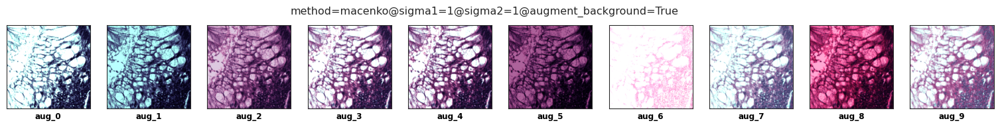

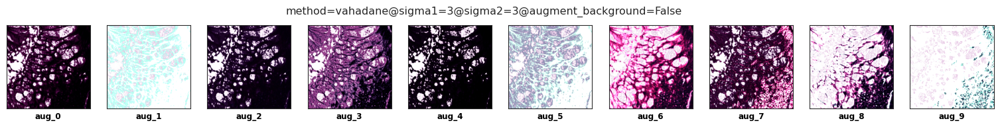

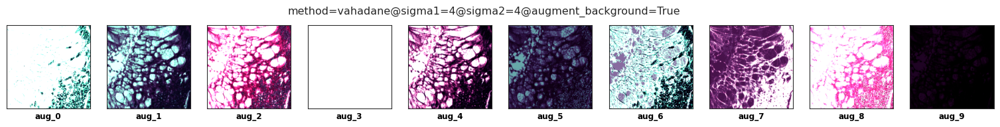

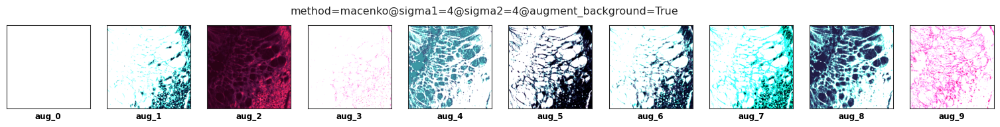

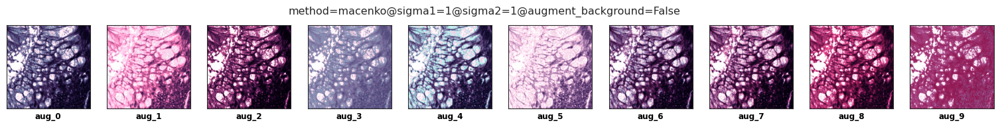

...

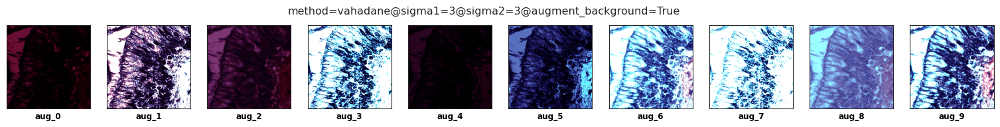

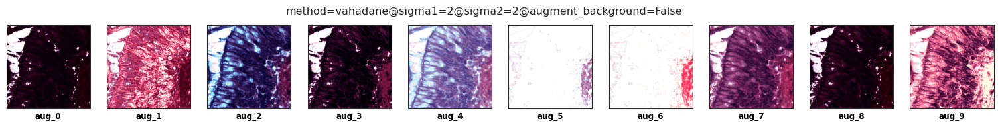

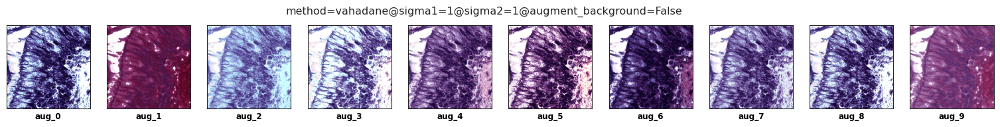

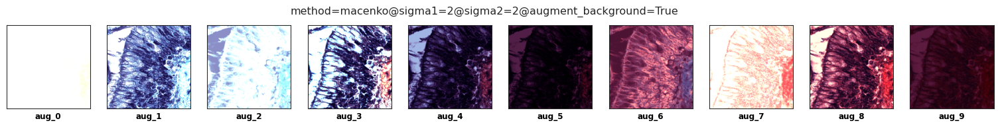

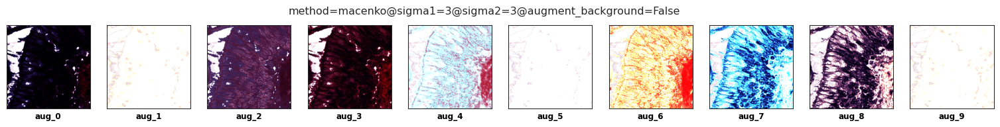

In [686]:
# Карта соответвий базовых изображений и имен
img_map = dict(
    zip(concated['url'].apply(ntpath.basename).values,
        concated['sample'].apply(lambda x: x.split('__')[0])))

for register in registers:
    display(
        HTML(
            f'<h3 align="center" style="color:green">Класс - {register.name.upper()}</h3>'
        ))
    for bi, img_type in zip(register.base_images,
                            [img_map[bi] for bi in register.base_images]):
        display(
            HTML(
                f'<h4 align="center" style="color:blue">' +
                f'Вероятность оригинального изображения - {img_type.upper()}</h4>'
            ))
        for param_id in register.aug_param_groups(bi):
            display(
                HTML(f'<h5 align="center">Набор параметров - {param_id}</h5>'))
            for value_id in register.aug_values_group(bi, param_id):
                augs = register.augmentations(bi, value_id)
                # Визуализация изображений
                img_arr = np.array([
                    plt.imread(
                        os.path.join(STAIN_AUGMENTATION2, register.name,
                                     aug.base_image_name,
                                     aug.full_name))[:, :, :3] for aug in augs
                ]).reshape((1, 10, CROP_WIDTH, CROP_HEIGHT, 3))
                Presentation().create_image_map(
                    imgs=img_arr,
                    all_bottom_titles=Enumerable(augs).select(
                        lambda x: f'aug_{x.number}').to_list(),
                    title=Enumerable(augs).select(
                        lambda x: x.pretty_params).to_list()[0],
                    fig_size=(20, 2),
                    hspace=0.01,
                    wspace=0.2,
                    title_font_size=12,
                    bottom_font_size=9,
                    style=3,
                    dpi=96)

#### Анализ аугментаций

##### Загрузка модели

In [687]:
# Загрузка модели из файла скрипта
resnet50_model = imp.load_source("model_resnet50",
                                 "models/resnet50/resnet50s.py").get_model(
                                     240, 3, 2)
# Загрузка весов
resnet50_model.load_weights(
    'models/resnet50/resnet50s_stage3_v2_model_7878_2_best.hdf5')
# Обрезка softmax слоя и создание модели
model = Model(inputs=resnet50_model.input,
              outputs=resnet50_model.layers[-2].output)

##### Анализ

In [690]:
AUG_REPORTS2 = 'data/aug_reports2/stain/'

In [691]:
# Создание объекта анализатора
ini = ImageNetINNvestigate(model=model, softmax_model=resnet50_model)

Creared 11 analyzers


In [692]:
preprocess_func = lambda x: (x.astype('float'))[:, :, :3].reshape(
    (1, 240, 240, 3))
postprocess_func = lambda x: np.array(x).reshape((len(x), 240, 240, 3))

# Карта соответвий базовых изображений и имен
img_map = dict(
    zip(concated['url'].apply(ntpath.basename).values,
        concated['sample'].apply(lambda x: x.split('__')[0])))

analyzed_result = {}
for register in registers:
    for bi, img_type in zip(register.base_images,
                            [img_map[bi] for bi in register.base_images]):
        for param_id in register.aug_param_groups(bi):
            augs = [
                register.augmentations(bi, value_id)
                for value_id in register.aug_values_group(bi, param_id)
            ]
            augs_list = Enumerable(augs).select_many(
                lambda x: x).to_list()  # Список аугментаций

            analyzed_names = Enumerable(augs_list).select(
                lambda x: x.value_id).to_list()  # Имена аугментаций

            img_array = [  # Читаем изображения
                plt.imread(
                    os.path.join(STAIN_AUGMENTATION2, register.name, bi,
                                 aug.full_name)) for aug in augs_list
            ]

            img_array.insert(  # Добавляем в нулевую позицию оригинальное изображение и его имя
                0, plt.imread(os.path.join(CROPS_PATH, CROPED_IMGS[0], bi)))
            analyzed_names.insert(0, 'original')

            preprocessed_imgs = [preprocess_func(img)
                                 for img in img_array]  # Делаем предобработку

            predicted_imgs = [  # Делаем предикты классов
                resnet50_model.predict(img) for img in preprocessed_imgs
            ]
            analyzed_imgs = [ini.analyze(img) for img in preprocessed_imgs
                             ]  # Анализируем изображения
            analyzed_imgs = [postprocess_func(img)
                             for img in analyzed_imgs]  # Постобработка
            analyzed_result[f'{register.name}_{img_type}'] = {
                "original_imgs": img_array,
                "analyzed_imgs": analyzed_imgs,
                "predicted_imgs": predicted_imgs,
                "analyzed_names": analyzed_names,
                "params": param_id
            }

##### Визуализация

In [23]:
class HtmlPrezentator:
    def _img_to_base64(self, img) -> str:
        """
        Конвертирует изображение в base64 строку
        """
        rawBytes = io.BytesIO()  # Байтовый поток
        plt.imsave(rawBytes, img)  # Записываем изображение в байтовый поток
        rawBytes.seek(0)  # Перемещаемся на начало
        readed = base64.b64encode(
            rawBytes.read()).decode()  # Получаем байты и декодируем в строку
        return readed


#     def _base64_to_html_img(self, base64: str):
#         return '<img width="70" alt="2d array" src="data:image/png;base64, ' + base64 + '"/>'

    def _base64_to_img_src(self, base64: str) -> str:
        """
        Возвращает атрибут src для изображения
        """
        return f'data:image/png;base64, {base64}'

    def _to_bold(self, element: str):
        return f"<b>{element}</b>"

    def _to_italic(self, element: str):
        return f"<i>{element}</i>"

    def _element_format(self, element: str, formatters: {}):
        funcs = {'bold': self._to_bold, 'italic': self._to_italic}
        elem = element
        for k, v in formatters.items():
            if v == True:
                elem = funcs[k](elem)
        return elem

    def _cell(self,
              img,
              left: str = None,
              top: str = None,
              right: str = None,
              bottom: str = None,
              img_width: int = 50,
              left_size: int = 10,
              top_size: int = 10,
              right_size: int = 10,
              bottom_size: int = 10,
              left_rotate: int = 0,
              top_rotate: int = 0,
              top_height: int = 70,
              right_rotate: int = 0,
              bottom_rotate: int = 0,
              top_bold: bool = False,
              top_italic: bool = False) -> Tag:
        td_root = Tag(name='td')  # Корневой td
        if right != None:  # Установлена правая подпись
            td_right = Tag(
                name='td',
                attrs={
                    'style':
                    f'font-size:{str(right_size)}px; vertical-align: bottom;'
                })
            td_right.insert(0, str(right))
            td_root.insert(0, td_right)
        main_td = Tag(name='td')  # Основной td
        if bottom != None:  # Правый p
            bottom_p = Tag(name='p',
                           attrs={'style': f'font-size:{str(bottom_size)}px;'})
            bottom_p.insert(0, bottom)
            main_td.insert(0, bottom_p)
        image = Tag(
            name='img',
            attrs={
                "style":
                f'min-width:{str(img_width)}px; max-width:{str(img_width)}px; border:1px solid black;',
                'src': f'{self._base64_to_img_src(self._img_to_base64(img))}'
            })  # Изображение
        main_td.insert(0, image)
        if top != None:
            top_p = Tag(
                name='p',
                attrs={
                    'style':
                    f'font-size:{str(top_size)}px; transform:rotate({top_rotate}deg); height:{top_height}px'
                })
            top_p.insert(
                0,
                self._element_format(top, {
                    'bold': top_bold,
                    'italic': top_italic
                }))
            main_td.insert(0, top_p)
        td_root.insert(0, main_td)
        if left != None:
            left_td = Tag(
                name='td',
                attrs={
                    'style':
                    f'font-size:{str(left_size)}px; vertical-align: bottom;'
                })
            left_td.insert(0, left)
            td_root.insert(0, left_td)
        return td_root

    def _row(self, cels: List[Tag]) -> Tag:
        pass

    def create_image_map(self,
                         imgs,
                         title: str = None,
                         table_title=None,
                         table_title_size=10,
                         title_bold=True,
                         title_italic=False,
                         top_only: List[str] = None,
                         left_only: List[str] = None,
                         right_only: List[str] = None,
                         top_size=10,
                         left_size=10,
                         right_size=10,
                         top_rotate=0,
                         top_bold=False,
                         top_italic=False,
                         top_height=70,
                         img_width=50,
                         blue_rows_index: List[int] = [],
                         green_rows_index: List[int] = [],
                         red_rows_index: List[int] = []):
        top_only_arr = top_only.copy() if top_only != None else None
        left_only_arr = left_only.copy() if left_only != None else None
        right_only_arr = right_only.copy() if right_only != None else None
        rows = len(imgs)
        row_arr = []  # Ряды таблтцы
        for row in range(rows):
            cols = len(imgs[row])
            row_tr = Tag(name='tr')  # Новый row
            if len(blue_rows_index
                   ) > 0 and row in blue_rows_index:  # Есть ряды для окраски
                row_tr = Tag(name='tr', attrs={'bgcolor':
                                               "#4da6ff"})  # Новый row
            if len(green_rows_index) > 0 and row in green_rows_index:
                row_tr = Tag(name='tr', attrs={'bgcolor':
                                               "#e6fff2"})  # Новый row
            if len(red_rows_index) > 0 and row in red_rows_index:
                row_tr = Tag(name='tr', attrs={'bgcolor':
                                               "#ffe6e6"})  # Новый row
            for col in range(cols):
                img = imgs[row, col]  # Текущее изображение
                # Если только для верхних подписей и текущий ряд - 0
                if top_only_arr != None and row == 0:
                    for_top_only = top_only_arr.pop(0)
                else:
                    for_top_only = None

                if left_only_arr != None and col == 0:
                    for_left_olnly = left_only_arr.pop(0)
                else:
                    for_left_olnly = None

                if right_only_arr != None and col == (cols - 1):
                    for_right_only = right_only_arr.pop(0)
                else:
                    for_right_only = None

                cell = self._cell(img=img,
                                  img_width=img_width,
                                  top=for_top_only,
                                  left=for_left_olnly,
                                  right=for_right_only,
                                  top_size=top_size,
                                  left_size=left_size,
                                  right_size=right_size,
                                  top_bold=top_bold,
                                  top_italic=top_italic,
                                  top_height=top_height,
                                  top_rotate=top_rotate)
                row_tr.append(cell)
            row_arr.append(row_tr)
        # Создание таблицы
        table = Tag(name='table')
        if table_title != None:  # Добавление заголовка таблицы
            caption = Tag(
                name='caption',
                attrs={'style': f'font-size:{str(table_title_size)}px;'})
            caption.insert(
                0,
                self._element_format(table_title, {
                    'bold': title_bold,
                    'italic': title_italic
                }))
            table.append(caption)
        for row in row_arr:
            table.append(row)

        # Основной div Image Grid
        main_div = Tag(name='div')
        # Заголовок отчета
        if title != None:
            title_h = Tag(name='h1')
            title_h.insert(0, title)
            main_div.insert(0, title_h)
        main_div.append(table)
        return self._format(main_div)

    def _format(self, obj):
        return obj.prettify().replace('&lt;', '<').replace('&gt;', '>')

In [694]:
for map_type, map_val in analyzed_result.items():
    ai = analyzed_result[map_type]['analyzed_imgs']  # Извлекаем analyzed_imgs
    oi = analyzed_result[map_type]['original_imgs']  # Извлекаем original_imgs
    used_anlyzers = ['original'] + list(ini.analyzers.keys())
    anal_names = analyzed_result[map_type]['analyzed_names']
    pred_imgs = analyzed_result[map_type]['predicted_imgs']
    params_id = analyzed_result[map_type]['params']

    # Карта соотвествий выбора
    predicted_map = {'follicular': 0, 'adenoma': 1}
    # Срез уверенность для определенного класса
    pred_imgs = [
        x[0][predicted_map[map_type.split('_')[0]]] for x in pred_imgs
    ]
    

    # Добавляем оригинальное неанализированное изображение в начало списка
    new_img_arr = []
    for ai_ind, oi in zip(list(range(len(ai))), oi):
        new_img_list = list(ai[ai_ind])
        new_img_list.insert(0, oi[:, :, :3])
        new_img_arr.append(new_img_list)

    # Сортировка по убыванию уверенгости предсказаний
    img_index = list(range(
        len(new_img_arr)))  # Индекс изображений для ускорения сортировки
    sort_df = pd.DataFrame({  # Отсортированный набор данных
        'params': anal_names,
        'predict': pred_imgs,
        'imgs': list(range(len(new_img_arr)))
    }).sort_values(by=['predict'], ascending=False)
    new_img_arr = [new_img_arr[ind] for ind in sort_df['imgs'].values
                   ]  # восстанавливаем порядок изображений
    pred_imgs = list(
        np.round(sort_df['predict'].values,
                 6))  # Извлекаем предсказания и округляем до 6 цифр
    anal_names = list(sort_df['params'].values)  # Извлекаем парметеры

    original_index = [i for i, x in enumerate(anal_names)
                      if x == 'original']  # Индекс оригинального изображения

    poor_predict_index = [  # Индексы с предсказаниями меньше оргинального
        i for i, x in enumerate(pred_imgs) if x < pred_imgs[original_index[0]]
    ]

    best_predict_index = [  # Индексы с предсказаниями больше оргинального
        i for i, x in enumerate(pred_imgs) if x > pred_imgs[original_index[0]]
    ]

#     # Карта изображений
    html = HtmlPrezentator().create_image_map(
        imgs=np.array(new_img_arr)[:],
        title=f'Анализ аугментаций - {str(map_type).upper()}',
        table_title=params_id,
        table_title_size=25,
        img_width=120,
        top_size=13,
        left_size=15,
        right_size=15,
        top_rotate=-20,
        top_bold=True,
        top_italic=True,
        top_height=80,
        top_only=list(
            pd.Series(used_anlyzers).apply(
                lambda x: '<br>'.join(x.split('_'))).values),
        left_only=list(
            pd.Series(anal_names).apply(
                lambda x: '<br>'.join(x.split('@'))).values[:]),
        right_only=pred_imgs[:],
        blue_rows_index=original_index,
        red_rows_index=poor_predict_index,
        green_rows_index=best_predict_index)
    open(f"{map_type}.html", "w").write(html)  # Сохраняем в HTML